In [1]:
import sys, os
from pyprojroot import here


# spyder up to find the root

local = here(project_files=[".local"])

# append to path
sys.path.append(str(local))

In [2]:
import jax
import jax.numpy as jnp
import jax.random as jrandom
import numpy as np
import xarray as xr
import pandas as pd
import flax
import imageio

import tqdm.notebook as tqdm
import equinox as eqx
from einops import rearrange

from sklearn.preprocessing import MinMaxScaler

import matplotlib.pyplot as plt
import hvplot.xarray

from src.utils import get_meshgrid

%load_ext autoreload
%autoreload 2

In [3]:
ds_grid = xr.open_zarr("/mnt/meom/workdir/johnsonj/data/qg_data/raw/temp.nc")
img = ds_grid.p.isel(steps=np.arange(350, 450, 10))
img

<xarray.DataArray 'p' (steps: 5, Nx: 512, Ny: 512)>
dask.array<getitem, shape=(5, 512, 512), dtype=float64, chunksize=(4, 64, 64), chunktype=numpy.ndarray>
Coordinates:
  * Nx       (Nx) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * Ny       (Ny) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * steps    (steps) int64 350 360 365 370 380

In [4]:
img.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="RdBu_r", title="Ground Truth")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (p)

In [5]:
# convert to dataframe
data = img.to_dataframe().reset_index()

# transform time coordinates
time_scaler = MinMaxScaler().fit(data["steps"].values[:, None])
data["steps"] = time_scaler.transform(data["steps"].values[:, None]).squeeze()

data.describe()

,steps,Nx,Ny,p
count,1.310720e+06,1.310720e+06,1.310720e+06,1.310720e+06
mean,5.000000e-01,-6.135923e-03,-6.135923e-03,7.875857e-16
std,3.333335e-01,1.813797e+00,1.813797e+00,7.317053e-01
min,0.000000e+00,-3.141593e+00,-3.141593e+00,-1.928650e+00
25%,3.333333e-01,-1.573864e+00,-1.573864e+00,-5.169000e-01
50%,5.000000e-01,-6.135923e-03,-6.135923e-03,3.753459e-02
75%,6.666667e-01,1.561592e+00,1.561592e+00,5.586359e-01
max,1.000000e+00,3.129321e+00,3.129321e+00,1.859928e+00


In [6]:
# values within the boundaries
filter1 = data["steps"] < 1.0
filter2 = data["steps"] > 0.0
conditions = [
    (data["steps"] < 1.0),
    (data["steps"] > 0.0)
]
choices = [0, 1]
data["mask"] = np.select(conditions, choices)

In [7]:
data.head()

,steps,Nx,Ny,p,mask
0,0.0,-3.141593,-3.141593,1.099264,0
1,0.0,-3.141593,-3.129321,1.086648,0
2,0.0,-3.141593,-3.117049,1.073248,0
3,0.0,-3.141593,-3.104777,1.059036,0
4,0.0,-3.141593,-3.092505,1.043991,0


In [8]:
x = data[data["mask"].isin([0])][["Nx", "Ny", "steps"]].values
y = data[data["mask"].isin([0])][["p"]].values



x.shape, y.shape

((1048576, 3), (1048576, 1))

In [9]:
from sklearn.model_selection import train_test_split

In [10]:
# split training and testing
idx_train, idx_test = train_test_split(data[data["mask"].isin([0])].index.values, train_size=0.01, random_state=123)

# split training and validation
idx_train, idx_valid = train_test_split(idx_train, test_size=0.1, random_state=123)

In [11]:
data["split"] = 0
data.loc[idx_train, "split"] = 1
data.loc[idx_valid, "split"] = 2
data.loc[idx_test, "split"] = 3
data.head()

,steps,Nx,Ny,p,mask,split
0,0.0,-3.141593,-3.141593,1.099264,0,3
1,0.0,-3.141593,-3.129321,1.086648,0,3
2,0.0,-3.141593,-3.117049,1.073248,0,3
3,0.0,-3.141593,-3.104777,1.059036,0,3
4,0.0,-3.141593,-3.092505,1.043991,0,3


In [12]:
xtrain = jnp.array(data[data["split"].isin([1])][["Nx", "Ny", "steps"]].values)
ytrain = jnp.array(data[data["split"].isin([1])][["p"]].values)
xvalid = jnp.array(data[data["split"].isin([2])][["Nx", "Ny", "steps"]].values)
yvalid = jnp.array(data[data["split"].isin([2])][["p"]].values)
xtest = jnp.array(data[data["split"].isin([3])][["Nx", "Ny", "steps"]].values)
ytest = jnp.array(data[data["split"].isin([3])][["p"]].values)

print(f"# Data: {x.shape[0]:_} \n# Train: {xtrain.shape[0]:_}\n# Valid: {xvalid.shape[0]:_}\n# Test: {xtest.shape[0]:_}")

# Data: 1_048_576 
# Train: 9_436
# Valid: 1_049
# Test: 1_038_091


In [13]:
from src.mlp import MLPNet
from src.siren import SirenNet

init_key = jrandom.PRNGKey(123)
in_dim = 3
out_dim = 1
hidden_dim = 256
n_hidden = 5



# # SIMPLE MLP
# model = MLPNet(
#     in_dim=in_dim,
#     out_dim=out_dim,
#     hidden_dim=hidden_dim, 
#     n_hidden=n_hidden, 
#     key=init_key
# )

# SIREN MODEL
w0_initial = 30.0
w0 = 1.0
final_scale = 1.0

model = SirenNet(
    in_dim=in_dim,
    out_dim=out_dim,
    hidden_dim=hidden_dim, 
    n_hidden=n_hidden,
    w0=w0,
    w0_initial=w0_initial,
    final_scale=final_scale,
    key=init_key
)


In [14]:
model

SirenNet(
  layers=[
    Siren(weight=f32[256,3], bias=f32[256], w0=30.0, activation=Sine(w0=30.0)),
    Siren(weight=f32[256,256], bias=f32[256], w0=1.0, activation=Sine(w0=1.0)),
    Siren(weight=f32[256,256], bias=f32[256], w0=1.0, activation=Sine(w0=1.0)),
    Siren(weight=f32[256,256], bias=f32[256], w0=1.0, activation=Sine(w0=1.0)),
    Siren(weight=f32[256,256], bias=f32[256], w0=1.0, activation=Sine(w0=1.0)),
    Siren(weight=f32[256,256], bias=f32[256], w0=1.0, activation=Sine(w0=1.0)),
    Siren(weight=f32[1,256], bias=f32[1], w0=1.0, activation=Identity())
  ],
  w0=1.0,
  final_scale=1.0,
  final_activation=Identity()
)

In [15]:
init_batch = xtrain[:100]
init_out = ytrain[:100]

out = jax.vmap(model)(init_batch)

# check sizes
assert out.shape == init_out.shape

In [16]:
out.shape, init_out.shape

((100, 1), (100, 1))

In [17]:
import optax

learning_rate = 1e-4

optim = optax.adam(learning_rate)
opt_state = optim.init(model)

In [18]:
@eqx.filter_jit
@eqx.filter_value_and_grad
def make_step(model, x, y):
    pred_y = jax.vmap(model)(x)
    # Trains with respect to binary cross-entropy
    return jnp.mean((pred_y - y)**2)

@eqx.filter_jit
def val_step(model, x, y):
    pred_y = jax.vmap(model)(x)
    # Trains with respect to binary cross-entropy
    return jnp.mean((pred_y - y)**2)
    

In [19]:
# loss, grads = make_step(model, xtrain[idx], ytrain[idx])
# perm = jrandom.permutation(key, indices)

In [ ]:
from src.data import make_mini_batcher

In [21]:
batch_size = 32
steps = 50_000

# keys for the permutations
# loader_key = jrandom.PRNGKey(42)
# indices = jnp.arange(x.shape[0])
# perm = jrandom.split(loader_key, steps)
train_ds = make_mini_batcher(xtrain, ytrain, batch_size, 1, shuffle=True)


losses = {} 
losses["train"] = []
losses["valid"] = []


with tqdm.trange(steps) as pbar:
    for step in pbar:
        
        # idx = jrandom.choice(perm[step], indices, shape=(batch_size,))
        # loss, grads = make_step(model, xtrain[idx], ytrain[idx])k
        
        ix, iy = ds_iter()
        loss, grads = make_step(model, ix, iy)
        
        updates, opt_state = optim.update(grads, opt_state)
        model = eqx.apply_updates(model, updates)
        
        losses["train"].append(loss)
        
        # validation step
        vloss = val_step(model, xvalid, yvalid)
        losses["valid"].append(vloss)
        
        if step % 100 == 0:
            pbar.set_description(f"Step: {step:_} | Train Loss: {loss:.3e} | Valid Loss: {vloss:.3e}")

2022-04-28 11:11:39.057454: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-04-28 11:11:39.057493: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)


  0%|          | 0/50000 [00:00<?, ?it/s]

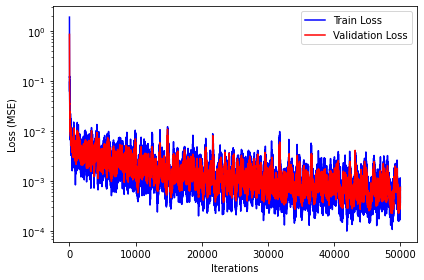

In [22]:
fig, ax = plt.subplots()

ax.plot(losses["train"], label="Train Loss", color="blue")
ax.plot(losses["valid"], label="Validation Loss", color="red")
ax.set(xlabel="Iterations", ylabel="Loss (MSE)", yscale="log")
plt.tight_layout()
plt.legend()
plt.show()

In [23]:
data["pred"] = np.asarray(jax.vmap(model)(jnp.asarray(data[["Nx", "Ny", "steps"]].values)))

## Results

In [ ]:
from src.preprocessing import create_da, create_mask

In [26]:
def create_da(coords, data, name="full_pred"):
    
    return pd.DataFrame(np.hstack([coords, data]), columns=["Nx", "Ny", "Nt", name]).set_index(["Nx", "Ny",  "Nt"]).to_xarray()

# def create_mask(coords, name="train", factor=1):
#     return create_da(coords, factor * np.ones((coords.shape[0],1)), name=name)

In [27]:
# # create data arrays
# data["pred"] = create_da(x, y, "true")

# # full predictions
# outputs = jax.vmap(model)(x)
# data = create_da(x, outputs, "pred")



In [28]:
def create_mask(coords, name="train", factor=1):
    return create_da(coords, factor * np.ones((coords.shape[0],1)), name=name)

In [29]:
# create masked arrays
mask_train = create_mask(xtrain, "train", 0)
mask_valid = create_mask(xvalid, "valid", 1)
mask_test = create_mask(xtest, "test", 2)

mask = xr.merge([mask_train, mask_valid, mask_test], compat='override')

mask["mask"] = 1 * np.ones((mask.dims["Nx"], mask.dims["Ny"], mask.dims["Nt"])) * np.isfinite(mask.train)
mask["mask"] += 2 * np.ones((mask.dims["Nx"], mask.dims["Ny"], mask.dims["Nt"])) * np.isfinite(mask.valid)
mask["mask"] += 3 * np.ones((mask.dims["Nx"], mask.dims["Ny"], mask.dims["Nt"])) * np.isfinite(mask.test)

In [30]:
mask

<xarray.Dataset>
Dimensions:  (Nx: 512, Ny: 512, Nt: 4)
Coordinates:
  * Nx       (Nx) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * Ny       (Ny) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * Nt       (Nt) float64 0.0 0.3333 0.5 0.6667
Data variables:
    train    (Nx, Ny, Nt) float64 nan nan nan nan nan ... nan nan nan nan nan
    valid    (Nx, Ny, Nt) float64 nan nan nan nan nan ... nan nan nan nan nan
    test     (Nx, Ny, Nt) float64 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0
    mask     (Nx, Ny, Nt) float64 3.0 3.0 3.0 3.0 3.0 ... 3.0 3.0 3.0 3.0 3.0

In [31]:
# ds = xr.merge([pred_true, pred_full], compat='override')
ds = data.set_index(["Nx", "Ny",  "steps"]).to_xarray()
ds

<xarray.Dataset>
Dimensions:  (Nx: 512, Ny: 512, steps: 5)
Coordinates:
  * Nx       (Nx) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * Ny       (Ny) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * steps    (steps) float64 0.0 0.3333 0.5 0.6667 1.0
Data variables:
    p        (Nx, Ny, steps) float64 1.099 1.092 1.138 ... 1.132 1.075 0.7915
    mask     (Nx, Ny, steps) int64 0 0 0 0 1 0 0 0 0 1 0 ... 0 0 0 0 1 0 0 0 0 1
    split    (Nx, Ny, steps) int64 3 3 3 3 0 3 3 3 3 0 3 ... 3 3 3 3 0 3 3 3 3 0
    pred     (Nx, Ny, steps) float32 1.13 1.155 1.117 ... 1.116 1.092 0.8436

In [32]:
ds["err_abs"] = np.abs(ds["p"] - ds["pred"])
ds["err_sq"] = (ds["p"] - ds["pred"])**2
ds["err_rsq"] = np.sqrt((ds["p"] - ds["pred"])**2)

In [33]:
ds.coords["mask"] = mask["mask"]
ds

<xarray.Dataset>
Dimensions:  (Nx: 512, Ny: 512, steps: 5, Nt: 4)
Coordinates:
  * Nx       (Nx) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * Ny       (Ny) float64 -3.142 -3.129 -3.117 -3.105 ... 3.105 3.117 3.129
  * steps    (steps) float64 0.0 0.3333 0.5 0.6667 1.0
    mask     (Nx, Ny, Nt) float64 nan nan nan nan nan ... nan nan nan nan nan
  * Nt       (Nt) float64 0.0 0.3333 0.5 0.6667
Data variables:
    p        (Nx, Ny, steps) float64 1.099 1.092 1.138 ... 1.132 1.075 0.7915
    split    (Nx, Ny, steps) int64 3 3 3 3 0 3 3 3 3 0 3 ... 3 3 3 3 0 3 3 3 3 0
    pred     (Nx, Ny, steps) float32 1.13 1.155 1.117 ... 1.116 1.092 0.8436
    err_abs  (Nx, Ny, steps) float64 0.03049 0.06306 0.02046 ... 0.01642 0.05215
    err_sq   (Nx, Ny, steps) float64 0.0009299 0.003977 ... 0.0002697 0.00272
    err_rsq  (Nx, Ny, steps) float64 0.03049 0.06306 0.02046 ... 0.01642 0.05215

### Calculate Gradients

In [ ]:
def calculate_gradient(da, edge_order=2):
    
    # second marginal derivative
    dx = da.differentiate(coord="Nx", edge_order=2)
    dy = da.differentiate(coord="Ny", edge_order=2)

    return 0.5 * (dx**2 + dy**2)

In [ ]:
ds["p_grad"] = calculate_gradient(ds["p"])
ds["pred_grad"] = calculate_gradient(ds["pred"])

#### Laplacian

In [ ]:
def calculate_laplacian(da, edge_order=2):
    
    # second marginal derivative
    dx2 = da.differentiate(coord="Nx", edge_order=2).differentiate(coord="Nx", edge_order=2)
    dy2 = da.differentiate(coord="Ny", edge_order=2).differentiate(coord="Ny", edge_order=2)

    return 0.5 * (dx2**2 + dy2**2)

In [ ]:
ds["p_lap"] = calculate_laplacian(ds["p"])
ds["pred_lap"] = calculate_laplacian(ds["pred"])

In [ ]:
mov = Movie(ds_grid.dp2.isel(steps=slice(155,None)), framedim="steps", cmap="RdBu_r")
mov.save(
    'movie_dp2_slow.gif',
    remove_movie=False,
    progress=True,
    framerate=1,
    gif_framerate=2,
    overwrite_existing=True,
)



In [34]:
ds.p.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="RdBu_r", title="Ground Truth")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (p)

In [35]:
ds.pred.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="RdBu_r", title="Predictions")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (pred)

In [36]:
ds.err_abs.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="viridis", title="Error (Absolute)")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (err_abs)

In [37]:
ds.err_sq.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="viridis", title="Error (Absolute)")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (err_sq)

In [38]:
ds.err_rsq.hvplot.image(x="Nx", y="Ny", width=500, height=400, cmap="viridis", title="Error (Absolute)")

:DynamicMap   [steps]
   :Image   [Nx,Ny]   (err_rsq)